# .wav to Spectrogram
The purpose of this notebook is to take our raw .wav files we have just converted and convert these into **Spectrograms.**

To learn more about **Spectrograms** check this amazing blog out: https://www.google.com/search?q=what+is+a+spectrogram&oq=what+is+a+spectrogram&aqs=chrome..69i57.1936j0j4&sourceid=chrome&ie=UTF-8 

We will be using:
* matplotlib
* scipy

In [5]:
import matplotlib.pyplot as plt
from scipy import signal
from scipy.io import wavfile
import os
import wave
import pylab

In [7]:
!ls

1_song_scraper.ipynb              raw_audio
2_mp3_wav_converter.ipynb         spectrograms
3_wav_spectrogram_converter.ipynb wav_spectrogram_converter.py
mp3_wav_converter.py              youtube-downloader
playlist_names


In [8]:
root_path = '/Users/diegomedina-bernal/Desktop/SpectroGram'
raw_fire_path = '/Users/diegomedina-bernal/Desktop/SpectroGram/raw_audio/fire'
raw_trash_path = '/Users/diegomedina-bernal/Desktop/SpectroGram/raw_audio/trash'
spectro_fire_path = '/Users/diegomedina-bernal/Desktop/SpectroGram/spectrograms/fire'
spectro_trash_path = '/Users/diegomedina-bernal/Desktop/SpectroGram/spectrograms/trash'

In [50]:
# converting into spectrograms
def graph_spectrogram(wav_file, dst_path, label, count):
    sound_info, frame_rate = get_wav_info(wav_file)
    pylab.figure(num=None, figsize=(19, 12))
    pylab.subplot(111)
    pylab.specgram(sound_info, Fs=frame_rate)
    pylab.axis('off')
    pylab.savefig(f'{dst_path}/{label}_{count}.png')
    
def get_wav_info(wav_file):
    wav = wave.open(wav_file, 'r')
    frames = wav.readframes(-1)
    sound_info = pylab.fromstring(frames, 'int16')
    frame_rate = wav.getframerate()
    wav.close()
    return sound_info, frame_rate

/Users/diegomedina-bernal/miniconda3/lib/python3.6/site-packages/ipykernel_launcher.py:13: DeprecationWarning: The binary mode of fromstring is deprecated, as it behaves surprisingly on unicode inputs. Use frombuffer instead
  del sys.path[0]
/Users/diegomedina-bernal/miniconda3/lib/python3.6/site-packages/matplotlib/axes/_axes.py:7585: RuntimeWarning: divide by zero encountered in log10
  Z = 10. * np.log10(spec)
/Users/diegomedina-bernal/miniconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:513: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


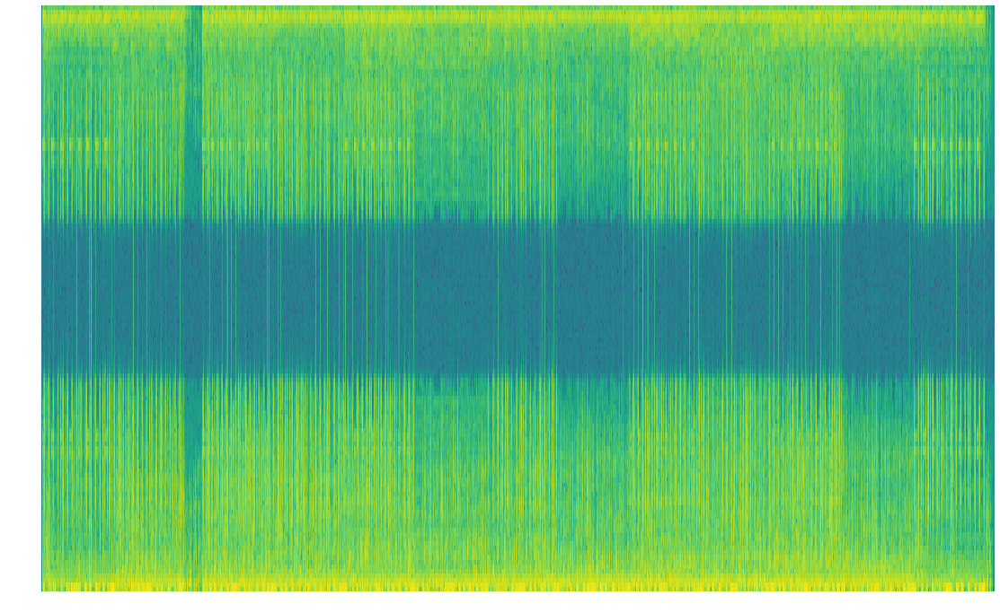

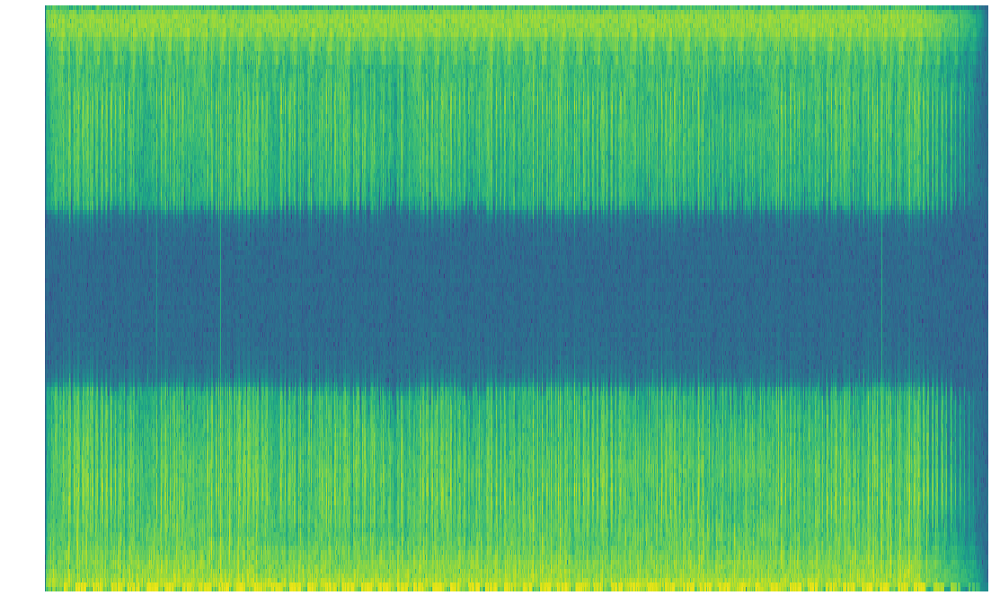

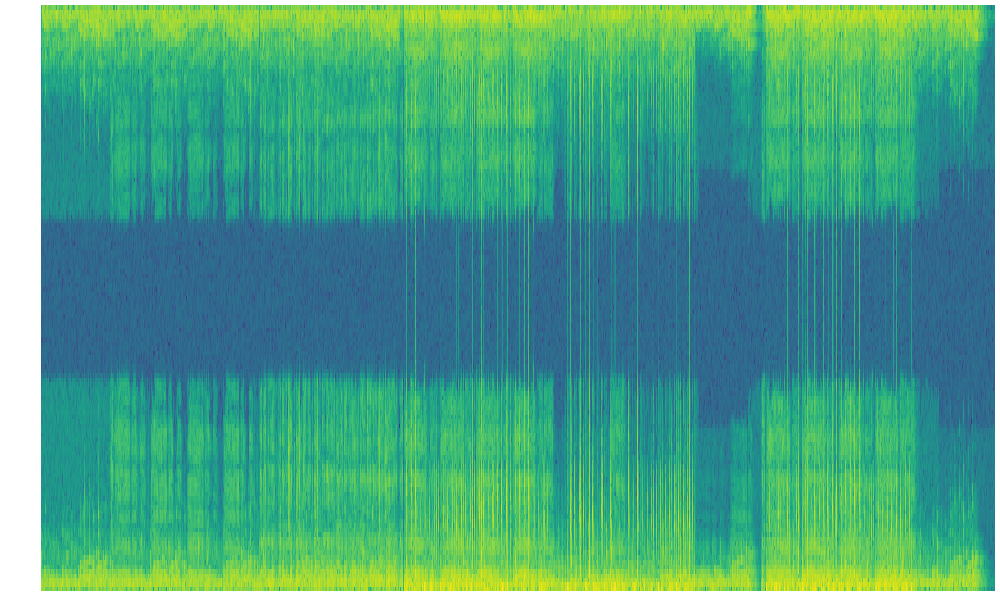

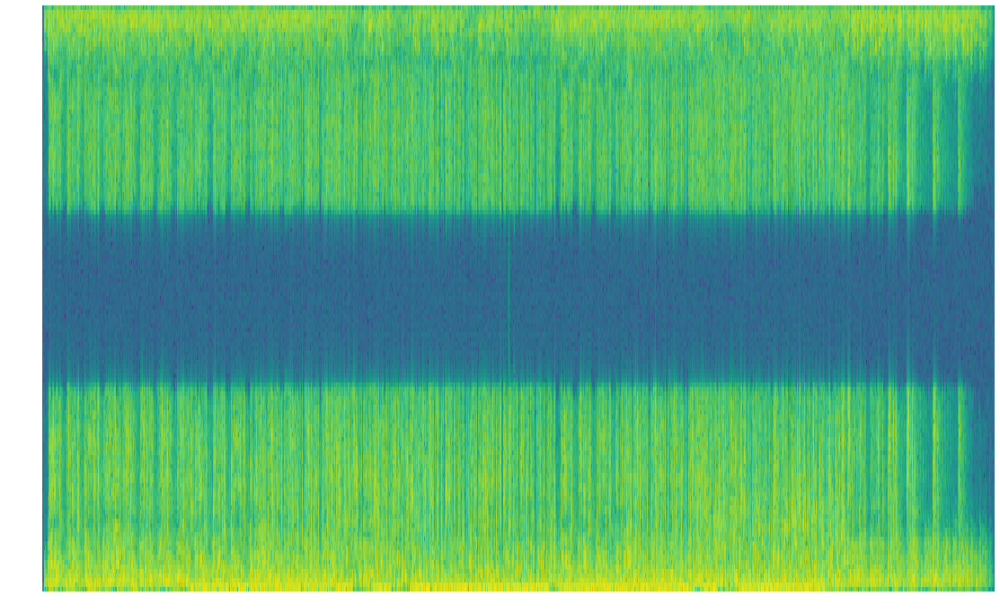

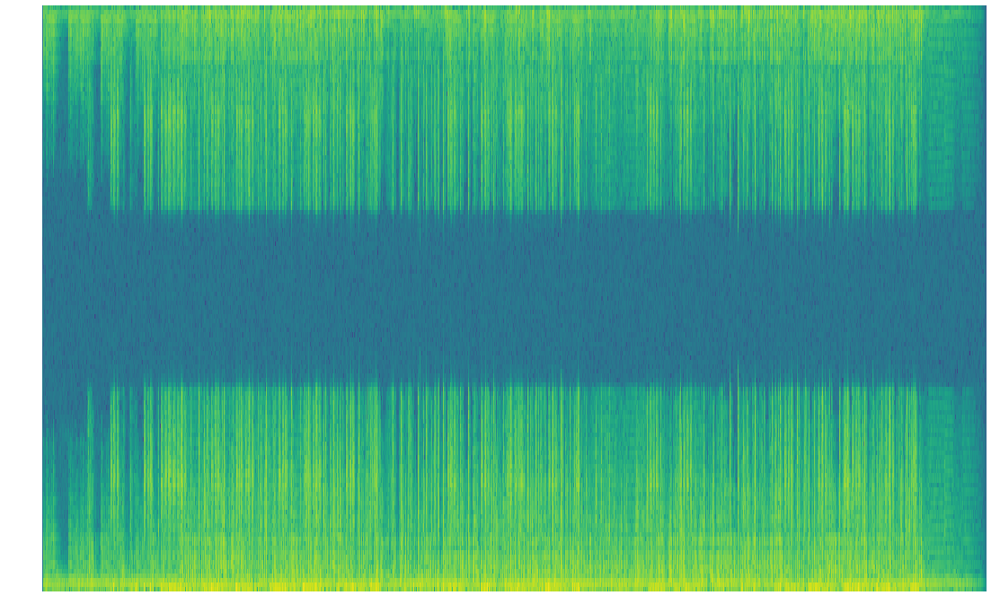

...

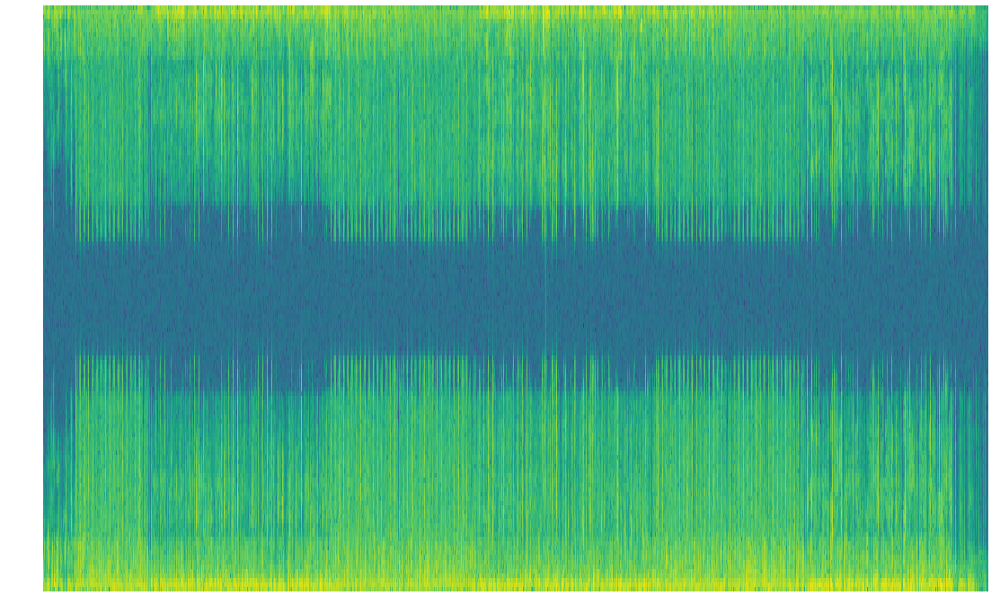

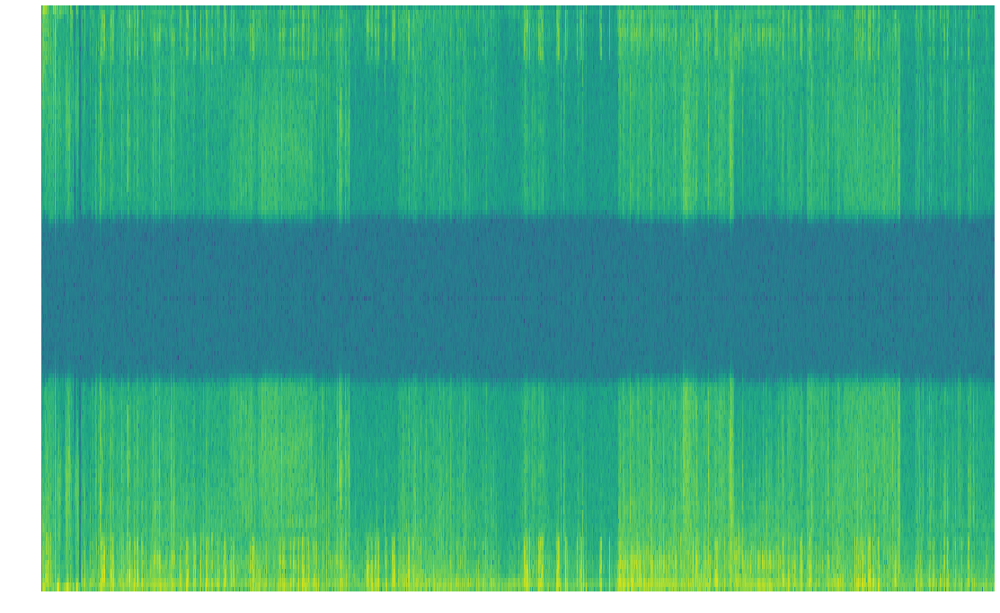

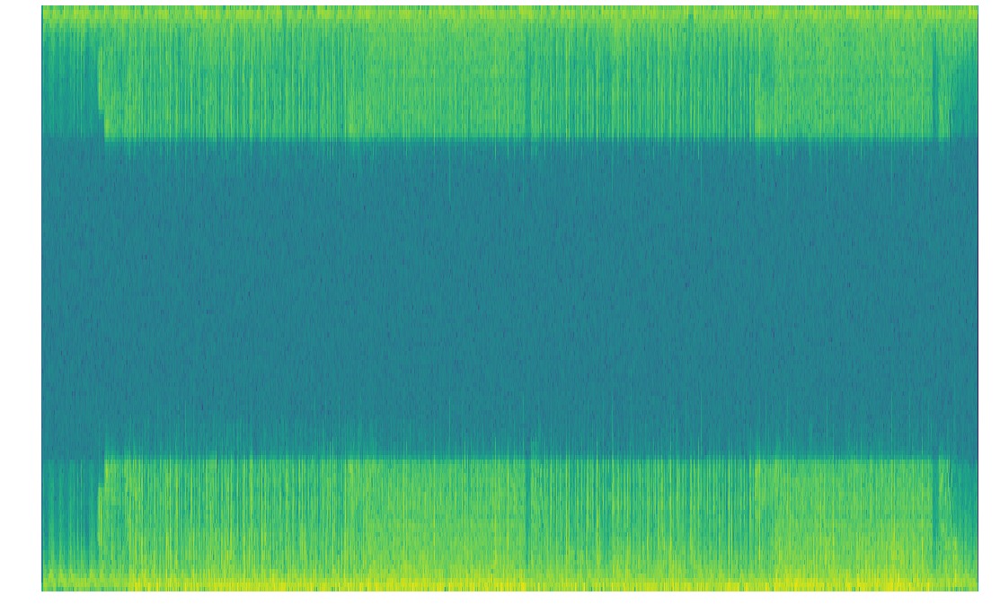

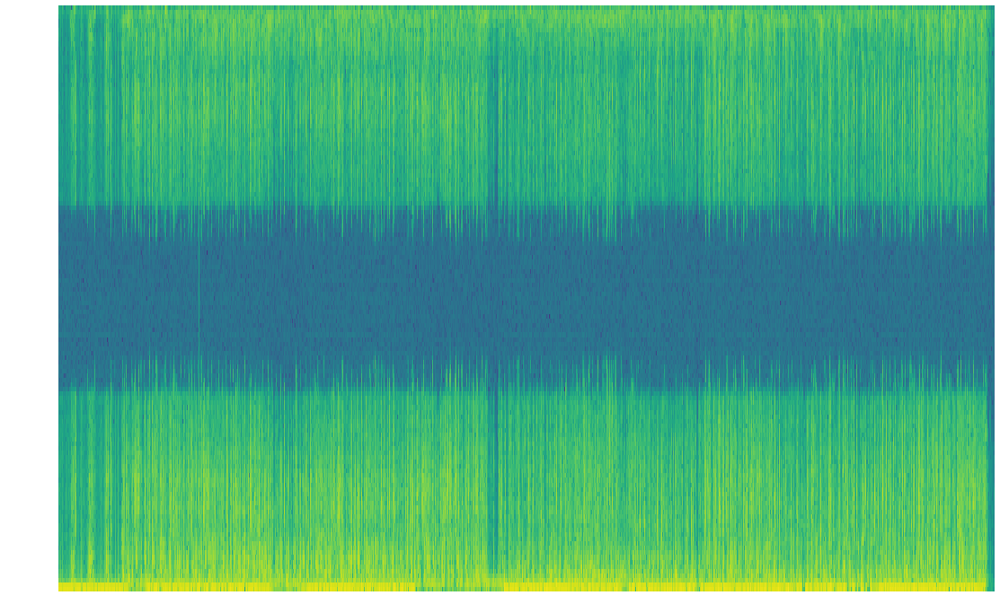

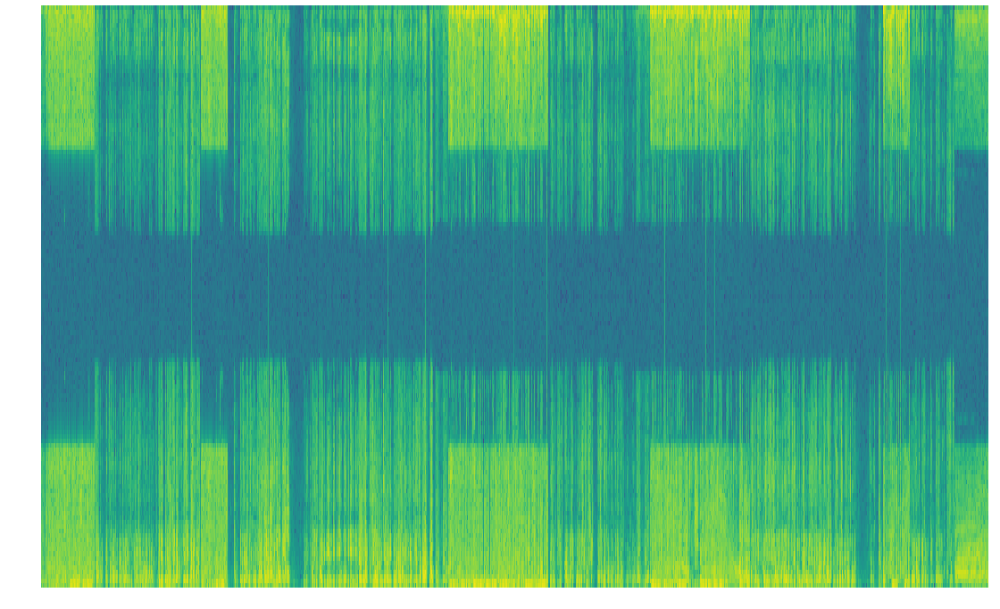

In [51]:
"""
IGNORE (when looping): '.localized' && '.ipynb_checkpoints'
"""

fire_count = 0
trash_count = 0

# looping through fire
for f in os.listdir(raw_fire_path):
    if f == '.localized' or f == '.ipynb_checkpoints':
        pass
    else:
        graph_spectrogram(f'{raw_fire_path}/{f}', spectro_fire_path, 'fire', fire_count)
        fire_count += 1
        
# looping through trash
for f in os.listdir(raw_trash_path):
    if f == '.localized' or f == '.ipynb_checkpoints':
        pass
    else:
        graph_spectrogram(f'{raw_trash_path}/{f}', spectro_trash_path, 'trash', trash_count)
        trash_count += 1